# Movimiento de la Kinesina
La Kinesina es un motor molecular. Transforma energía de la molécula de ATP en trabajo mecánico útil para transportar vesículas a lo largo de microtúbulos al interior de las células en una dirección preferencial.
En este codigo se busca simular el movimiento de la kinesina a lo largo de un microtubulo mediante un el método de Leap Frog estadisitico impulsivo (método descrito en el paper Efficient Algorithms for Langevin and DPD Dynamics), replicando asi los resultados del paper Model for hand-over-hand motion of molecular motors

Kinesin is a molecular motor. It transforms energy from the ATP molecule into mechanical work useful for transporting vesicles along microtubules inside cells in a preferential direction.
In this code we seek to simulate the movement of kinesin along a microtubule by means of an impulsive statistical Leap Frog method (method described in the paper Efficient Algorithms for Langevin and DPD Dynamics), replicating the results of the paper Model for hand-over-hand motion of molecular motors.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
!pip install cython

In [ ]:
%load_ext Cython

## Implementación del Leap Frog Estdistico impulsivo

El algoritmo es el siguiente:

\begin{aligned}
& v=v\left(t-\frac{1}{2} h\right)+a h \\
& \Delta v=-f v+\sqrt{f(2-f)\left(k_{\mathrm{B}} T_{\mathrm{ref}} / m\right)} \xi \\
& x(t+h)=x(t)+\left(v+\frac{1}{2} \Delta v\right) h \\
& v\left(t+\frac{1}{2} h\right)=v+\Delta v \\
\end{aligned}

Siendo a

\begin{aligned}
&a=-\nabla \frac{V_1(x, y)}{m}=-\nabla \frac{V_{1 x}(x)}{m}-\nabla \frac{V_{1 y}(y)}{m} \\
& -\nabla \frac{V_{1 y}(y)}{m}=-\frac{k_y}{m} y \quad \quad-\nabla \frac{V_{1 x}(x)}{m}= \begin{cases}-\frac{V_0}{m x_M} & \text { si } 0 \leq x \leq x_M, \\
\frac{V_0}{m\left(2 l_0-x_M\right)} & \text { si } x_M \leq x \leq 2 l_0 .\end{cases} \\
\end{aligned}

EL codigo fue implementado en cython. Cython es un compilador estático optimizador tanto para el lenguaje de programación Python como para el lenguaje de programación Cython extendido (basado en Pyrex). Hace que escribir extensiones C para Python sea tan fácil como el propio Python.

In [ ]:
%%cython
import numpy as np
cimport numpy as np
def difusionC(double t_0, double t_f, int steps, np.ndarray[double, ndim=1] ci, np.ndarray[double, ndim=1] parameters, np.ndarray[double, ndim=1] state):
    cdef double dt = (t_f - t_0)/steps
    cdef np.ndarray[np.double_t, ndim=1] x = np.zeros(steps)
    cdef np.ndarray[np.double_t, ndim=1] y = np.zeros(steps)
    cdef np.ndarray[np.double_t, ndim=1] vx = np.zeros(steps + 1)
    cdef np.ndarray[np.double_t, ndim=1] vy = np.zeros(steps + 1)
    cdef double kb = 1.0
    cdef double alpha = 1.0 - np.exp(-parameters[0] * dt) # 1.0 - np.exp(-gamma * dt)
    cdef double l_2o = 2 * parameters[5] #parameters[5] = l_o
    cdef double x_i = ci[0]

    cdef double m = parameters[2]
    cdef double V_o = parameters[3]
    cdef double x_m = parameters[4]
    cdef double ky = parameters[6]

    #cdef double K = parameters[7]
    #cdef double R0 = parameters[8]
    #cdef L0 = parameters[9]

    cdef int j = 0
    cdef double a

    x[0] = ci[0]
    y[0] = ci[2]
    vx[0] = ci[1] - (dt*V_o)/(2*((l_2o-x_m)*m))
    vx[1] = ci[1]
    vy[0] = ci[3] +  (dt*ky*ci[2])/(2*m)
    vy[1] = ci[3]


    for i in range(1, steps):
      if x_i <= x_m:
        ax = -V_o/(m*x_m)*state[i]
      elif x_i > x_m:
        ax = V_o/((l_2o-x_m)*m)*state[i]
      elif x_i >= l_2o:
        j =+ 1
        ax = -V_o/(m*x_m)*state[i]

      ay = -1 * (ky * y[i-1])

      ######## Calculate potential  FENE #######
      #r = np.sqrt(x[i]**2 + y[i]**2)

      #if (L0 - R0) < r  and r < (L0 + R0):
      #  a_fene = (K * R0**2 / m) * (L0 - r) / (R0**2 - r**2 + 2*r*L0 - L0**2)
      #else:
      #  a_fene = 0

      ########## Velocity coordenates ##########
      v_xprim = vx[i] + ax*dt #+ a_fene*dt
      v_yprim = vy[i] + ay*dt #+ a_fene*dt

      ########## X #############
      delta_v = -alpha * v_xprim + (np.sqrt(alpha * (2 - alpha) * kb * parameters[1] / m)) * np.random.normal(0, 1) #parameters[1] = T
      vx[i + 1] = v_xprim + delta_v
      x[i] = x[i - 1] + (v_xprim + 0.5 * delta_v) * dt
      x_i = x[i]-l_2o*j

      ########## Y #############
      delta_vy = -alpha * v_yprim + (np.sqrt(alpha * (2 - alpha) * kb * parameters[1] / m)) * np.random.normal(0, 1) #parameters[1] = T
      vy[i + 1] = v_yprim + delta_vy
      y[i] = y[i - 1] + (v_yprim + 0.5 * delta_vy) * dt

    return x, vx[1:], y, vy[1:]

In [ ]:
#Parametros de la simulación
t_0,t_f = 0,50
steps = t_f*100
t = np.linspace(t_0,t_f,steps)
ci = np.array([0.0,10.0,0.0,10.0]) #double x0, double vx0, double y0, double vy0
parameters = np.array([1.0,4.0,1.0,5.0,1.5,1.0,1.0]) #gamma, T, m, V_o, x_m, l_o, ky
#parameters = np.array([4.7*10**-11,0.05,1.0,20.0*0.05,0.5,8.3,1.0,10,0.4,8.3]) #gamma, T, m, V_o, x_m, l_o, ky, K, R0, L0
iterations = 1

#Potencial prendido o apagado
state1, state2 = np.zeros(steps), np.zeros(steps)
t_Pot = 500

for i in range(0, steps):
  if (i % t_Pot*3 <= t_Pot*1.5):
    state2[i] = 0
  elif(i % t_Pot*3 <= t_Pot*2.5):
    state2[i] = 1
  else:
    state2[i] = 0
  if (i % t_Pot*3 <= t_Pot):
    state1[i] = 1
  else:
    state1[i] = 0
# state = np.zeros((2,steps))
# state[0] = state1
# state[1] = state2

In [ ]:
%%time
results1 = []
results2 = []
for i in range(iterations):
  results1.append(difusionC(t_0,t_f,steps,ci,parameters,state1))
  results2.append(difusionC(t_0,t_f,steps,ci,parameters,state2))

CPU times: user 133 ms, sys: 915 µs, total: 134 ms
Wall time: 141 ms


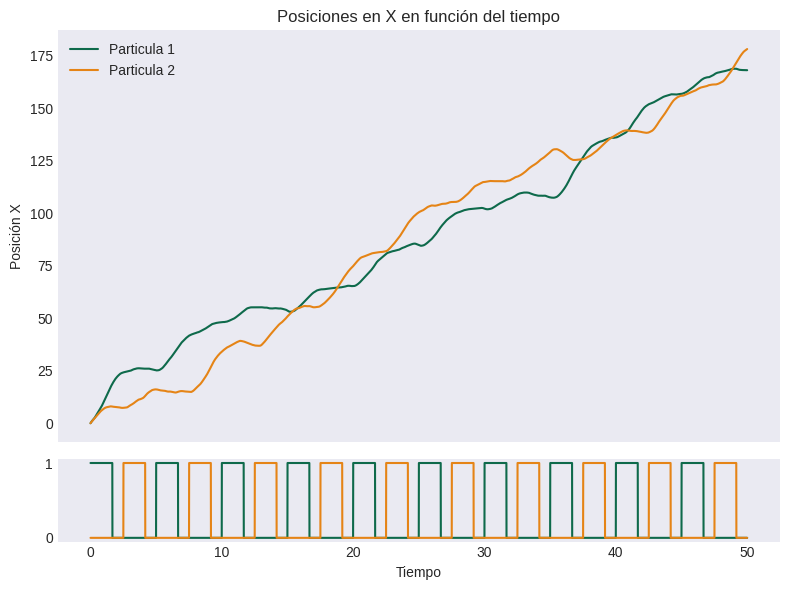

In [ ]:
plt.style.use('seaborn-v0_8-dark')
fig, axs = plt.subplots(2, 1, figsize=(8, 6), gridspec_kw={'height_ratios': [5, 1]})
# Grafico del promedio de las posiciones
axs[0].plot(t, results1[i][0],color='#0E6A4B', label='Particula 1')
axs[0].plot(t, results2[i][0],color='#E58416', label='Particula 2')
axs[0].set_title('Posiciones en X en función del tiempo')
axs[0].set_ylabel('Posición X')
axs[0].legend()
axs[0].set_xticks([])

# Grafico potenciales
axs[1].plot(t, state1,color='#0E6A4B')
axs[1].plot(t, state2,color='#E58416')
axs[1].set_xlabel('Tiempo')

plt.tight_layout()
plt.show()

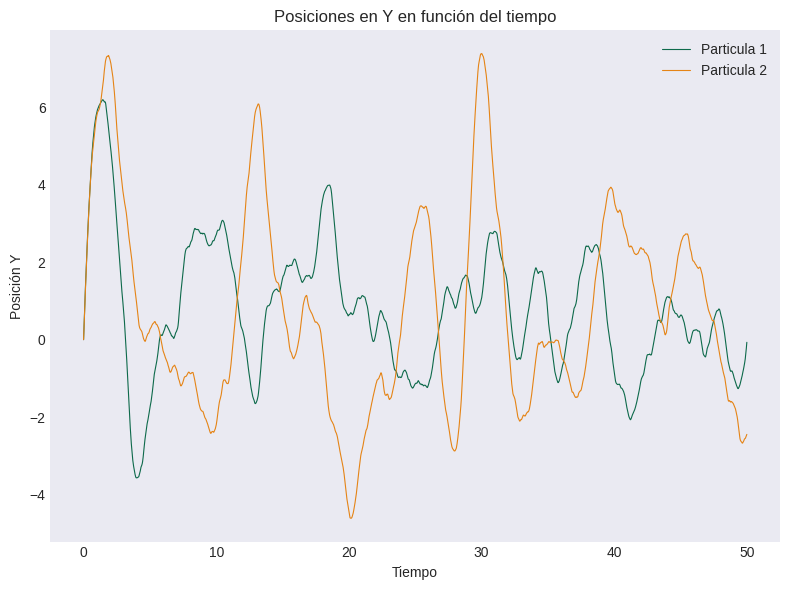

In [ ]:
plt.figure(figsize=(8, 6))
# Grafico del promedio de las posiciones
plt.plot(t, results1[i][2],color='#0E6A4B', label='Particula 1', linewidth = 0.8)
plt.plot(t, results2[i][2],color='#E58416', label='Particula 2', linewidth = 0.8)
plt.title('Posiciones en Y en función del tiempo')
plt.xlabel('Tiempo')
plt.ylabel('Posición Y')
plt.legend()
plt.tight_layout()
plt.show()

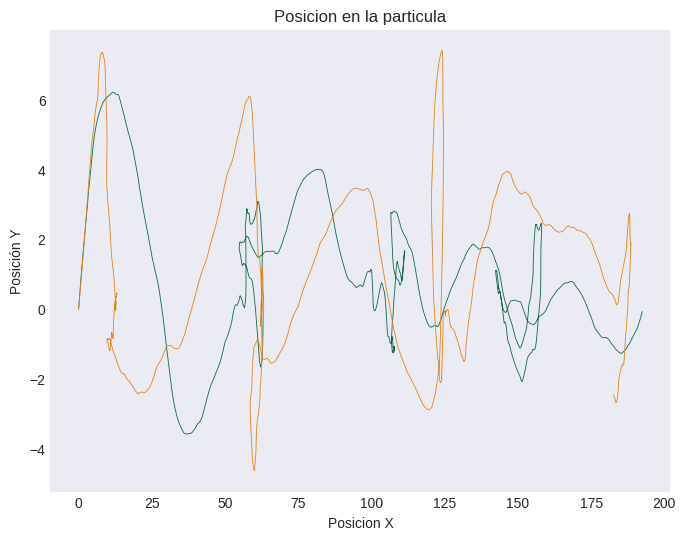

In [ ]:
plt.figure(figsize=(8, 6))
plt.plot(results1[i][0], results1[i][2],color='#0E6A4B', label='Particula 1',linewidth = 0.6)
plt.plot(results2[i][0], results2[i][2],color='#E58416', label='Particula 2',linewidth = 0.6)
plt.xlabel("Posicion X")
plt.ylabel("Posición Y")
plt.title("Posicion en la particula")
plt.show()

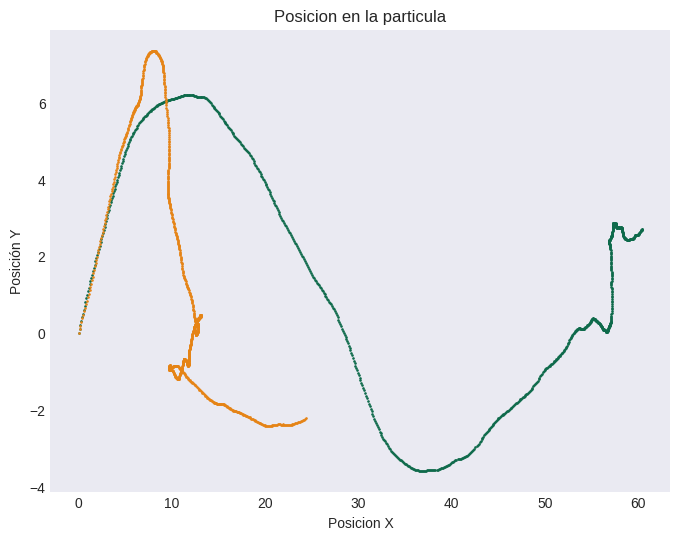

In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(results1[i][0][:1000], results1[i][2][:1000],color='#0E6A4B', label='Particula 1',s=0.8)#,linewidth = 0.6)
plt.scatter(results2[i][0][:1000], results2[i][2][:1000],color='#E58416', label='Particula 2',s=0.8)#,linewidth = 0.6)
plt.xlabel("Posicion X")
plt.ylabel("Posición Y")
plt.title("Posicion en la particula")
plt.show()

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

<ipython-input-12-50a92ade8ad1>:24: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  line.set_data(x, y)
<ipython-input-12-50a92ade8ad1>:24: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  line.set_data(x, y)


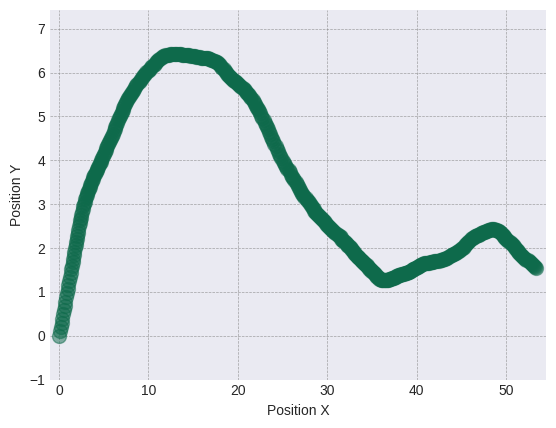

In [ ]:
# Datos de ejemplo
vector1 = results1[0][0][:500]
vector2 = results1[0][2][:500]

#vector3 = results2[0][0][:400]
#vector4 = results2[0][2][:400]

# Configuración inicial de la gráfica
fig, ax = plt.subplots()
line, = ax.plot([], [], 'o', markersize=10, alpha = 0.9, color='#0E6A4B')

def init():
    ax.set_xlim(min(vector1)-1, max(vector1) + 1)
    ax.set_ylim(min(vector2)-1, max(vector2) + 1)
    ax.set_xlabel('Position X')
    ax.set_ylabel('Position Y')
    ax.grid(True, linestyle='--', linewidth=0.5, color='gray', alpha=0.7)
    return line,

def update(frame):
    x = vector1[frame]
    y = vector2[frame]

    line.set_data(x, y)

    # Actualizar los puntos anteriores con menor opacidad
    if frame > 0:
        prev_x = vector1[:frame]
        prev_y = vector2[:frame]
        line.set_data(prev_x, prev_y)
        line.set_alpha(0.5)
    return line,

# Crear la animación
ani = FuncAnimation(fig, update, frames=len(vector1), init_func=init, blit=True)
ani.save('Kinesin_movement.gif', writer='imagemagick')
# Mostrar la animación en Colab
HTML(ani.to_jshtml())